In [1]:
import google.generativeai as genai
import pathlib
import textwrap
from IPython.display import display, Markdown


c:\Users\HP\Generative-AI-Sunny-Sir\venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
def to_markdown(text):
    text = text.replace('.',' *')
    return Markdown(textwrap.indent(text, '> ',predicate=lambda _:True))


#Example
input_text = "This is a . sample text with bullet points."
result = to_markdown(input_text)

display(result)

> This is a  * sample text with bullet points *

In [3]:
# Used to securely store your API key
#from google.colab import userdata
#GOOGLE_API_KEY = userdata.get("GOOGLE_API_KEY")
#genai.configure(api_key = GOOGLE_API_KEY)

In [4]:
import os
from dotenv import load_dotenv
load_dotenv()

True

In [5]:
import os

GOOGLE_API_KEY = os.getenv("GOOGLE_API_KEY")

if GOOGLE_API_KEY:
    print("API Key found!")
else:
    print("API Key not found. Set it as an environment variable.")


API Key found!


In [6]:
for models in genai.list_models():
    print(models)

Model(name='models/chat-bison-001',
      base_model_id='',
      version='001',
      display_name='PaLM 2 Chat (Legacy)',
      description='A legacy text-only model optimized for chat conversations',
      input_token_limit=4096,
      output_token_limit=1024,
      supported_generation_methods=['generateMessage', 'countMessageTokens'],
      temperature=0.25,
      max_temperature=None,
      top_p=0.95,
      top_k=40)
Model(name='models/text-bison-001',
      base_model_id='',
      version='001',
      display_name='PaLM 2 (Legacy)',
      description='A legacy model that understands text and generates text as an output',
      input_token_limit=8196,
      output_token_limit=1024,
      supported_generation_methods=['generateText', 'countTextTokens', 'createTunedTextModel'],
      temperature=0.7,
      max_temperature=None,
      top_p=0.95,
      top_k=40)
Model(name='models/embedding-gecko-001',
      base_model_id='',
      version='001',
      display_name='Embedding Gecko

In [7]:
for models in genai.list_models():
    if 'generateContent' in models.supported_generation_methods:
        print(models.name)

models/gemini-1.0-pro-latest
models/gemini-1.0-pro
models/gemini-pro
models/gemini-1.0-pro-001
models/gemini-1.0-pro-vision-latest
models/gemini-pro-vision
models/gemini-1.5-pro-latest
models/gemini-1.5-pro-001
models/gemini-1.5-pro-002
models/gemini-1.5-pro
models/gemini-1.5-flash-latest
models/gemini-1.5-flash-001
models/gemini-1.5-flash-001-tuning
models/gemini-1.5-flash
models/gemini-1.5-flash-002
models/gemini-1.5-flash-8b
models/gemini-1.5-flash-8b-001
models/gemini-1.5-flash-8b-latest
models/gemini-1.5-flash-8b-exp-0827
models/gemini-1.5-flash-8b-exp-0924
models/gemini-2.0-flash-exp
models/gemini-2.0-flash
models/gemini-2.0-flash-001
models/gemini-2.0-flash-lite-preview
models/gemini-2.0-flash-lite-preview-02-05
models/gemini-2.0-pro-exp
models/gemini-2.0-pro-exp-02-05
models/gemini-exp-1206
models/gemini-2.0-flash-thinking-exp-01-21
models/gemini-2.0-flash-thinking-exp
models/gemini-2.0-flash-thinking-exp-1219
models/learnlm-1.5-pro-experimental


## **Generate text from text inputs**

In [ ]:
model = genai.GenerativeModel('gemini-pro')

In [9]:
%%time
response = model.generate_content("What is the meaning of life?")

CPU times: total: 15.6 ms
Wall time: 6.98 s


In [10]:
response.text

'The meaning of life is a deeply personal and philosophical question that has been pondered by humans for millennia. There is no single, universally accepted answer, as the meaning of life is likely to vary depending on individual beliefs, values, and experiences.\n\nSome common perspectives on the meaning of life include:\n\n* **Finding purpose and fulfillment:** This view suggests that the meaning of life lies in discovering what gives you purpose and fulfillment. This could involve pursuing a career that you are passionate about, engaging in hobbies that you enjoy, or contributing to your community.\n* **Living in the present moment:** This perspective emphasizes the importance of living in the present moment and savoring each experience. It suggests that the meaning of life is found in the simple joys and experiences of everyday life.\n* **Making a positive impact on the world:** This view suggests that the meaning of life lies in making a positive impact on the world. This could i

In [11]:
response.candidates

[content {
  parts {
    text: "The meaning of life is a deeply personal and philosophical question that has been pondered by humans for millennia. There is no single, universally accepted answer, as the meaning of life is likely to vary depending on individual beliefs, values, and experiences.\n\nSome common perspectives on the meaning of life include:\n\n* **Finding purpose and fulfillment:** This view suggests that the meaning of life lies in discovering what gives you purpose and fulfillment. This could involve pursuing a career that you are passionate about, engaging in hobbies that you enjoy, or contributing to your community.\n* **Living in the present moment:** This perspective emphasizes the importance of living in the present moment and savoring each experience. It suggests that the meaning of life is found in the simple joys and experiences of everyday life.\n* **Making a positive impact on the world:** This view suggests that the meaning of life lies in making a positive im

In [12]:
response.prompt_feedback

In [13]:
response.parts

[text: "The meaning of life is a deeply personal and philosophical question that has been pondered by humans for millennia. There is no single, universally accepted answer, as the meaning of life is likely to vary depending on individual beliefs, values, and experiences.\n\nSome common perspectives on the meaning of life include:\n\n* **Finding purpose and fulfillment:** This view suggests that the meaning of life lies in discovering what gives you purpose and fulfillment. This could involve pursuing a career that you are passionate about, engaging in hobbies that you enjoy, or contributing to your community.\n* **Living in the present moment:** This perspective emphasizes the importance of living in the present moment and savoring each experience. It suggests that the meaning of life is found in the simple joys and experiences of everyday life.\n* **Making a positive impact on the world:** This view suggests that the meaning of life lies in making a positive impact on the world. This 

---

In [14]:
%%time
response = model.generate_content("What is the meaning of life?", stream = True)
for chunk in response:
    print(chunk.text)
    print("_"*80)

The meaning of life is a philosophical question that has been debated for centuries. There
________________________________________________________________________________
 is no one definitive answer, as the meaning of life is likely to be different for each individual. However, some common themes that emerge in discussions about the meaning
________________________________________________________________________________
 of life include:

1. **Purpose:** Some people believe that the meaning of life is to fulfill a specific purpose, such as raising a family, achieving success in one's career, or making a positive contribution to society.
2. **Happiness:** Others believe that the meaning of life is to be happy
________________________________________________________________________________
. This could involve pursuing activities that bring joy and fulfillment, or simply living each day to the fullest.
3. **Connection:** Many people find meaning in life through their relationships with

ValueError: Invalid operation: The `response.text` quick accessor requires the response to contain a valid `Part`, but none were returned. The candidate's [finish_reason](https://ai.google.dev/api/generate-content#finishreason) is 4. Meaning that the model was reciting from copyrighted material.

---

---

In [15]:
!curl -o image.jpg https://t0.gstatic.com/licensed-image?q=tbn:ANd9GcQ_Kevbk21QBRy-PgB4kQpS79brbmmEG7m3VOTShAn4PecDU5H5UxrJxE3Dw1JiaG17V88QIol19-3TM2wCHw

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed

  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
  0     0    0     0    0     0      0      0 --:--:--  0:00:01 --:--:--     0
  0     0    0     0    0     0      0      0 --:--:--  0:00:01 --:--:--     0
100  405k  100  405k    0     0   168k      0  0:00:02  0:00:02 --:--:--  169k


In [16]:
!curl -o image.jpg https://images.pexels.com/photos/414612/pexels-photo-414612.jpeg?cs=srgb&dl=pexels-james-wheeler-414612.jpg&fm=jpg


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed

  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 1499k  100 1499k    0     0  1554k      0 --:--:-- --:--:-- --:--:-- 1558k
'dl' is not recognized as an internal or external command,
operable program or batch file.
'fm' is not recognized as an internal or external command,
operable program or batch file.


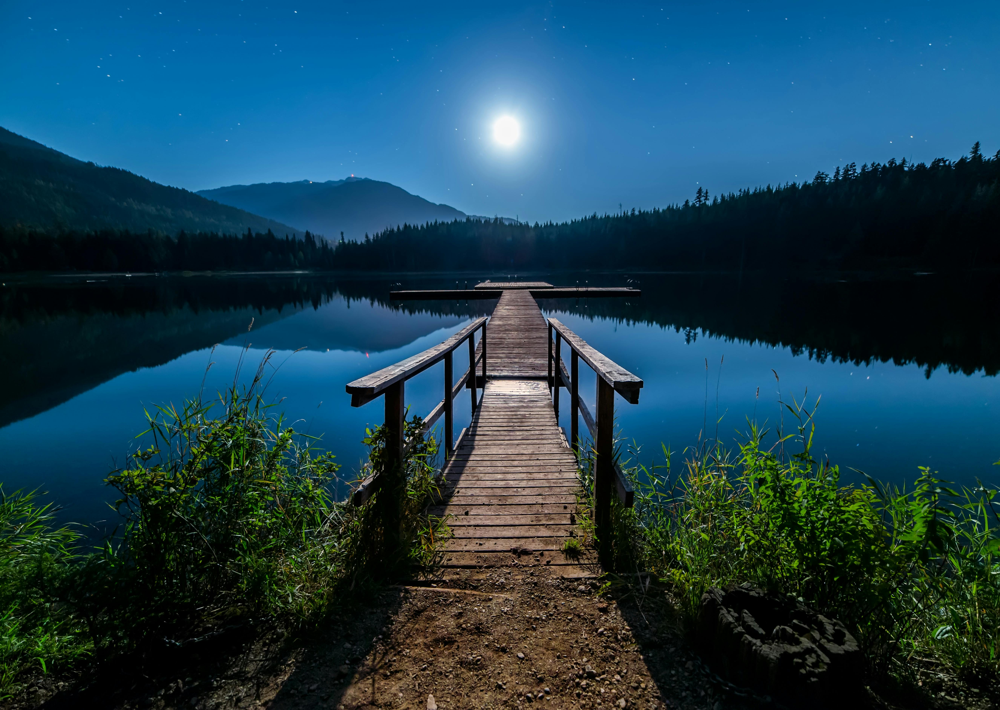

In [17]:
import PIL.Image

img = PIL.Image.open('image.jpg')
img

In [18]:
model1 = genai.GenerativeModel('gemini-1.5-flash-001')

In [19]:
import google.generativeai as genai

model = genai.GenerativeModel("gemini-pro-vision")  # Supports image input
response = model1.generate_content(img)  # img should be in the correct format


In [20]:
response

response:
GenerateContentResponse(
    done=True,
    iterator=None,
    result=protos.GenerateContentResponse({
      "candidates": [
        {
          "content": {
            "parts": [
              {
                "text": "The image shows a wooden dock extending into a calm lake under a starry sky. The moon is bright and illuminates the water, creating a reflection of the surrounding forest. The scene is peaceful and serene, perfect for a contemplative moment."
              }
            ],
            "role": "model"
          },
          "finish_reason": "STOP",
          "index": 0,
          "safety_ratings": [
            {
              "category": "HARM_CATEGORY_SEXUALLY_EXPLICIT",
              "probability": "NEGLIGIBLE"
            },
            {
              "category": "HARM_CATEGORY_HATE_SPEECH",
              "probability": "NEGLIGIBLE"
            },
            {
              "category": "HARM_CATEGORY_HARASSMENT",
              "probability": "NEGLIGIBLE

In [21]:
print("The End")

The End
